In [37]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go
import plotly.express as px
import math
import requests
from io import StringIO

In [38]:
uw = pd.read_csv(r'C:\Users\pomar\Downloads\uw_weather.csv')
etch_roof = pd.read_csv(r'C:\Users\pomar\Downloads\etch_roof_weather.csv')

In [39]:
display(uw)

,deviceTime_utc,deviceTime_local,deviceTime_unix,temperature,pressure,humidity,error_flag
0,2019-05-31 21:45:12+00:00,2019-05-31 14:45:12-07:00,1.559339e+09,24.01,1015.78,52.91,NaN
1,2019-05-31 21:50:12+00:00,2019-05-31 14:50:12-07:00,1.559339e+09,24.18,1015.76,52.34,NaN
2,2019-05-31 21:55:12+00:00,2019-05-31 14:55:12-07:00,1.559340e+09,24.29,1015.70,51.94,NaN
3,2019-05-31 22:00:12+00:00,2019-05-31 15:00:12-07:00,1.559340e+09,24.38,1015.63,51.58,NaN
4,2019-05-31 22:05:12+00:00,2019-05-31 15:05:12-07:00,1.559340e+09,24.46,1015.59,51.29,NaN
...,...,...,...,...,...,...,...
216814,2023-04-05 19:40:45+0000,2023-04-05 12:40:45-0700,1.680724e+09,17.90,1014.97,32.83,0.0
216815,2023-04-05 19:45:45+0000,2023-04-05 12:45:45-0700,1.680724e+09,18.00,1014.93,32.55,0.0
216816,2023-04-05 19:50:45+0000,2023-04-05 12:50:45-0700,1.680724e+09,18.11,1014.90,32.34,0.0
216817,2023-04-05 19:55:45+0000,2023-04-05 12:55:45-0700,1.680725e+09,18.19,1014.84,32.32,0.0


In [40]:
# uw.columns.get_loc("2023-02-01 00:01:34+0000")
print(np.where(uw["deviceTime_utc"]=="2023-02-01 00:01:34+0000"))
print(np.where(uw["deviceTime_utc"]=="2023-02-05 00:01:34+0000"))

(array([212346], dtype=int64),)
(array([213498], dtype=int64),)


In [41]:
our_splice = uw.loc[212346:213498,:]

In [42]:
display(our_splice)

,deviceTime_utc,deviceTime_local,deviceTime_unix,temperature,pressure,humidity,error_flag
212346,2023-02-01 00:01:34+0000,2023-01-31 16:01:34-0800,1.675210e+09,13.47,1016.23,34.58,0.0
212347,2023-02-01 00:06:34+0000,2023-01-31 16:06:34-0800,1.675210e+09,13.38,1016.20,34.72,0.0
212348,2023-02-01 00:11:34+0000,2023-01-31 16:11:34-0800,1.675210e+09,13.45,1016.18,34.75,0.0
212349,2023-02-01 00:16:34+0000,2023-01-31 16:16:34-0800,1.675211e+09,13.35,1016.16,34.99,0.0
212350,2023-02-01 00:21:34+0000,2023-01-31 16:21:34-0800,1.675211e+09,13.31,1015.97,34.96,0.0
...,...,...,...,...,...,...,...
213494,2023-02-04 23:41:34+0000,2023-02-04 15:41:34-0800,1.675554e+09,18.36,1006.57,50.02,0.0
213495,2023-02-04 23:46:34+0000,2023-02-04 15:46:34-0800,1.675554e+09,18.23,1006.47,50.32,0.0
213496,2023-02-04 23:51:34+0000,2023-02-04 15:51:34-0800,1.675555e+09,18.02,1006.33,50.78,0.0
213497,2023-02-04 23:56:34+0000,2023-02-04 15:56:34-0800,1.675555e+09,17.74,1006.24,51.90,0.0


In [43]:
print(our_splice["deviceTime_utc"][212347])

2023-02-01 00:06:34+0000


In [44]:
mean_temp_splice = (uw["temperature"].sum())/(len(uw["temperature"]))
print(mean_temp_splice)
display(our_splice["deviceTime_utc"])

19.543445685110626


212346    2023-02-01 00:01:34+0000
212347    2023-02-01 00:06:34+0000
212348    2023-02-01 00:11:34+0000
212349    2023-02-01 00:16:34+0000
212350    2023-02-01 00:21:34+0000
                    ...           
213494    2023-02-04 23:41:34+0000
213495    2023-02-04 23:46:34+0000
213496    2023-02-04 23:51:34+0000
213497    2023-02-04 23:56:34+0000
213498    2023-02-05 00:01:34+0000
Name: deviceTime_utc, Length: 1153, dtype: object

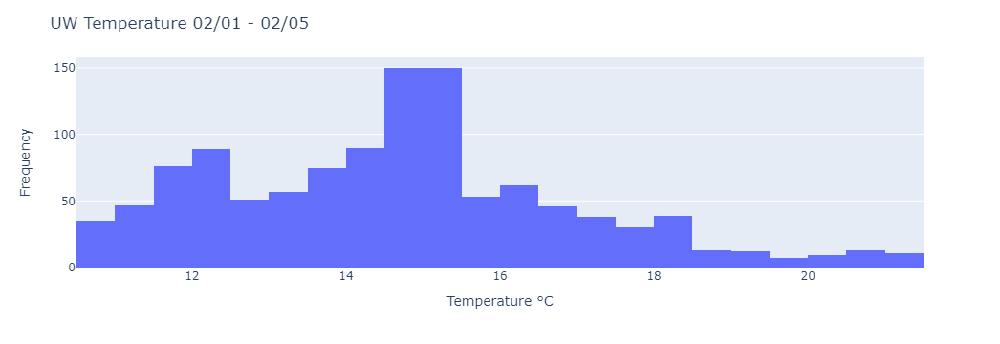

In [45]:
# our_splice = px.data.tips()
# fig = px.histogram(our_splice, x=uw["deviceTime_local"], y=uw["temperature"])
# update_layout(xaxis_title="Time", yaxis_title="Temperature")
# fig = px.histogram(our_splice, x=our_splice["deviceTime_utc"], y=our_splice["temperature"])
fig = px.histogram(our_splice, x=our_splice["temperature"])
fig.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="Temperature °C",yaxis_title="Frequency" )
fig.show()

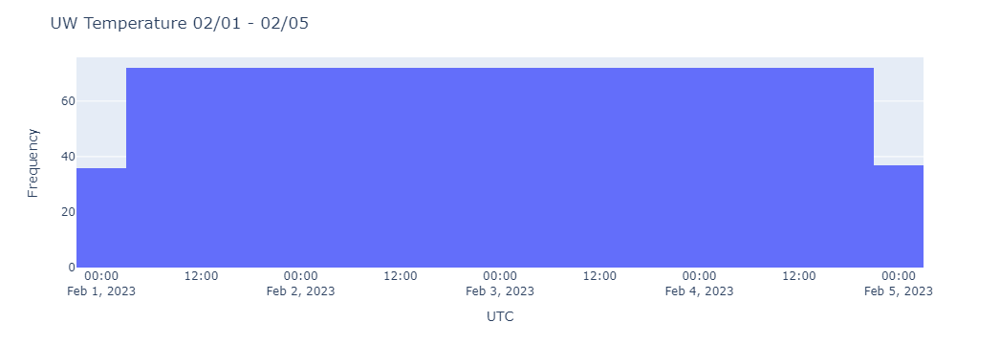

In [46]:
fig = px.histogram(our_splice, x=our_splice["deviceTime_utc"])
fig.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="UTC",yaxis_title="Frequency" )
fig.show()

In [47]:
desired = []
save = []
days = ["2023-02-01","2023-02-02","2023-02-03","2023-02-04"]
counter = 0
for i in range(212346,213499):
    if days[counter] in our_splice["deviceTime_utc"][i]:
        save.append(our_splice["temperature"][i])
    else:
        meantemp = sum(save)/len(save)
        desired.append(meantemp)
        save = []
        counter = counter + 1

print(desired)

[13.020416666666664, 14.2916724738676, 15.785818815331007, 15.531637630662017]


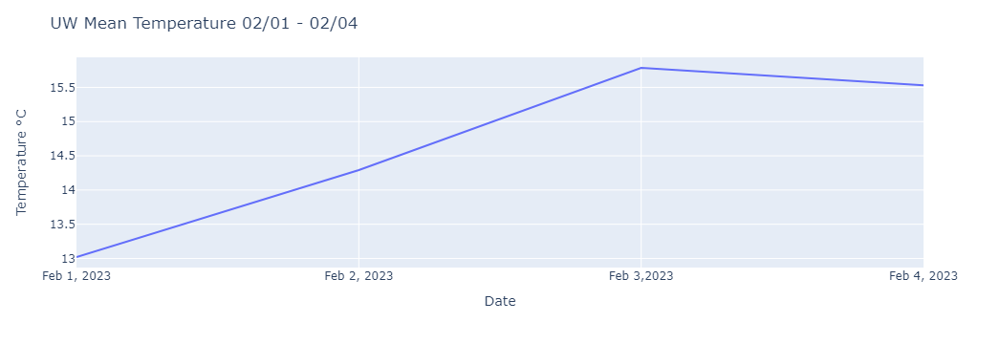

In [48]:
fig = px.line(x=["Feb 1, 2023","Feb 2, 2023","Feb 3,2023", "Feb 4, 2023"], y=desired)
fig.update_layout(title="UW Mean Temperature 02/01 - 02/04",xaxis_title="Date",yaxis_title="Temperature °C" )
fig.show()

In [49]:
display(etch_roof)

,deviceTime_utc,deviceTime_local,deviceTime_unix,temperature,pressure,humidity,error_flag
0,2017-11-17 18:40:49+00:00,2017-11-17 10:40:49-08:00,1.510944e+09,17.57,1008.59,52.71,NaN
1,2017-11-17 18:45:49+00:00,2017-11-17 10:45:49-08:00,1.510944e+09,17.04,1008.65,54.04,NaN
2,2017-11-17 18:50:49+00:00,2017-11-17 10:50:49-08:00,1.510945e+09,16.58,1008.61,54.75,NaN
3,2017-11-17 18:55:49+00:00,2017-11-17 10:55:49-08:00,1.510945e+09,16.39,1008.62,56.20,NaN
4,2017-11-17 19:00:49+00:00,2017-11-17 11:00:49-08:00,1.510945e+09,16.20,1008.62,57.27,NaN
...,...,...,...,...,...,...,...
240781,2022-09-08 10:05:42+0000,2022-09-08 03:05:42-0700,1.662632e+09,26.74,997.36,37.73,0.0
240782,2022-09-08 10:10:42+0000,2022-09-08 03:10:42-0700,1.662632e+09,26.35,997.34,38.01,0.0
240783,2022-09-08 10:15:42+0000,2022-09-08 03:15:42-0700,1.662632e+09,26.67,997.35,37.09,0.0
240784,2022-09-08 10:20:42+0000,2022-09-08 03:20:42-0700,1.662632e+09,26.72,997.32,36.61,0.0


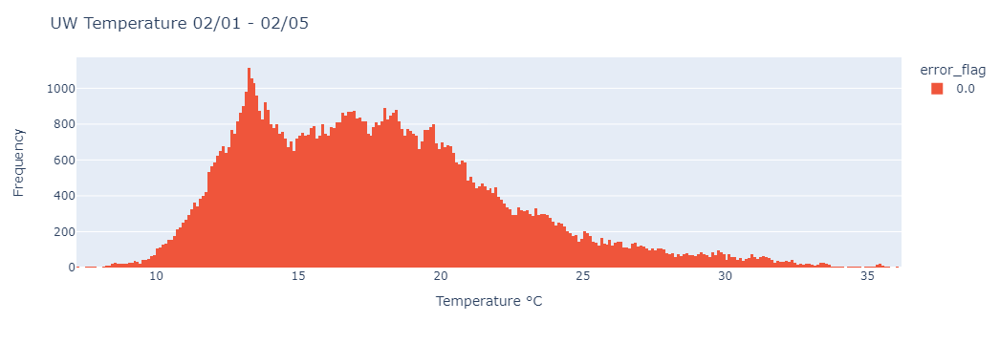

In [50]:
fig2 = px.histogram(etch_roof, x=etch_roof["temperature"], color = 'error_flag')
fig2.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="Temperature °C",yaxis_title="Frequency", barmode="overlay")
fig2.show()

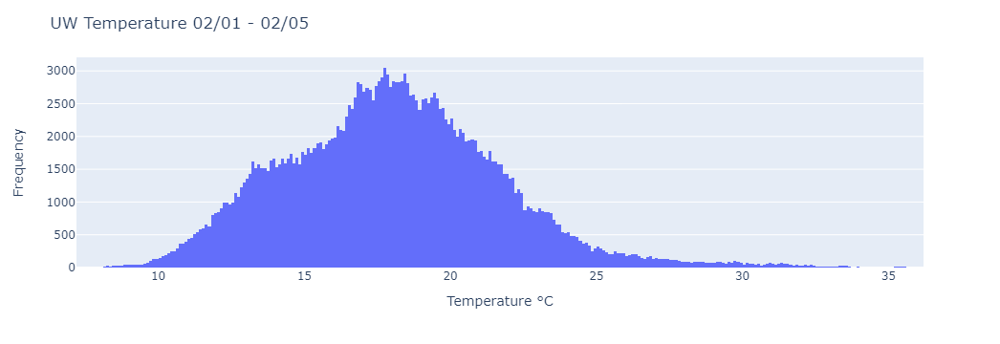

In [51]:
fig2 = px.histogram(etch_roof, x=etch_roof["temperature"])
fig2.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="Temperature °C",yaxis_title="Frequency", barmode="overlay")
fig2.show()

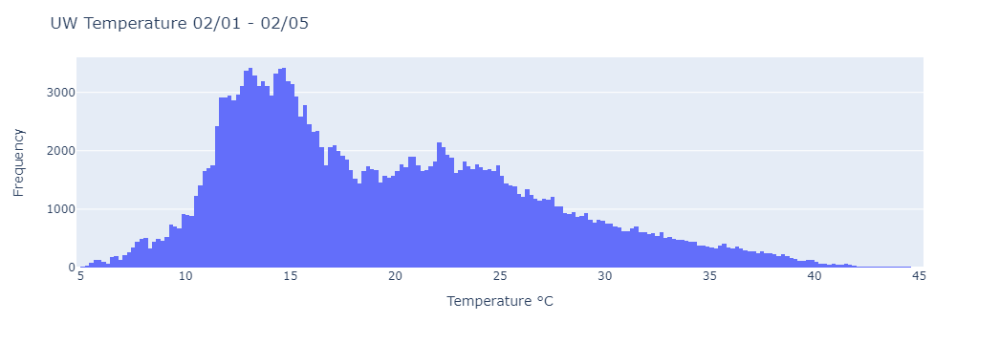

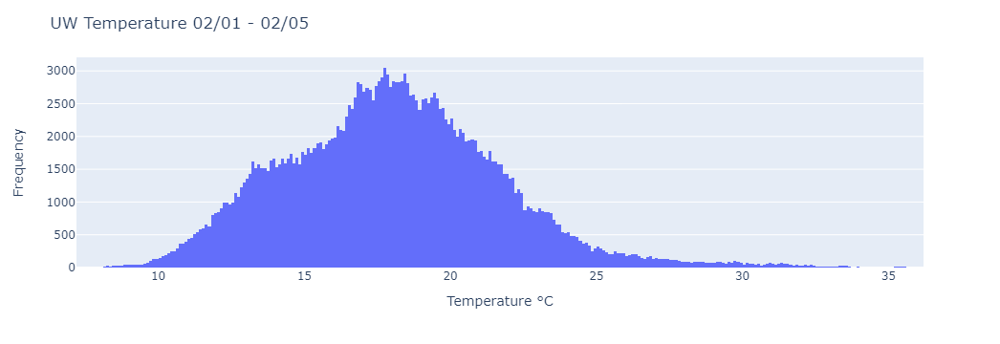

In [52]:
#Whole data Histograms

fig = px.histogram(uw, x=uw["temperature"])
fig.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="Temperature °C",yaxis_title="Frequency", barmode="overlay")
fig2 = px.histogram(etch_roof, x=etch_roof["temperature"])
fig2.update_layout(title="UW Temperature 02/01 - 02/05",xaxis_title="Temperature °C",yaxis_title="Frequency", barmode="overlay")
fig.show()
fig2.show()


In [53]:
indicator_uw = []
for i in range(len(uw)):
    indicator_uw.append("UW Data")

# indicator_dic_uw = ["indicator" : indicator_uw]

uw2 = uw.assign(indicator=indicator_uw)

indicator_etch = []
for i in range(len(etch_roof)):
    indicator_etch.append("Etcheverry Roof Data")

etch_roof2 = etch_roof.assign(indicator=indicator_etch)

prelim = [uw2, etch_roof2]
concatenated = pd.concat(prelim)
display(concatenated)

,deviceTime_utc,deviceTime_local,deviceTime_unix,temperature,pressure,humidity,error_flag,indicator
0,2019-05-31 21:45:12+00:00,2019-05-31 14:45:12-07:00,1.559339e+09,24.01,1015.78,52.91,NaN,UW Data
1,2019-05-31 21:50:12+00:00,2019-05-31 14:50:12-07:00,1.559339e+09,24.18,1015.76,52.34,NaN,UW Data
2,2019-05-31 21:55:12+00:00,2019-05-31 14:55:12-07:00,1.559340e+09,24.29,1015.70,51.94,NaN,UW Data
3,2019-05-31 22:00:12+00:00,2019-05-31 15:00:12-07:00,1.559340e+09,24.38,1015.63,51.58,NaN,UW Data
4,2019-05-31 22:05:12+00:00,2019-05-31 15:05:12-07:00,1.559340e+09,24.46,1015.59,51.29,NaN,UW Data
...,...,...,...,...,...,...,...,...
240781,2022-09-08 10:05:42+0000,2022-09-08 03:05:42-0700,1.662632e+09,26.74,997.36,37.73,0.0,Etcheverry Roof Data
240782,2022-09-08 10:10:42+0000,2022-09-08 03:10:42-0700,1.662632e+09,26.35,997.34,38.01,0.0,Etcheverry Roof Data
240783,2022-09-08 10:15:42+0000,2022-09-08 03:15:42-0700,1.662632e+09,26.67,997.35,37.09,0.0,Etcheverry Roof Data
240784,2022-09-08 10:20:42+0000,2022-09-08 03:20:42-0700,1.662632e+09,26.72,997.32,36.61,0.0,Etcheverry Roof Data


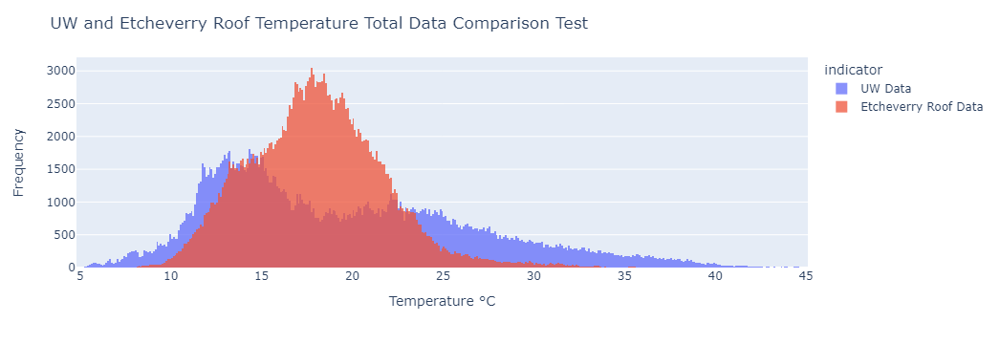

In [54]:
fig2 = px.histogram(concatenated, x=concatenated["temperature"], color = 'indicator')
fig2.update_layout(title="UW and Etcheverry Roof Temperature Total Data Comparison Test",xaxis_title="Temperature °C",yaxis_title="Frequency", barmode="overlay")
fig2.update_traces(opacity=0.75)
fig2.show()


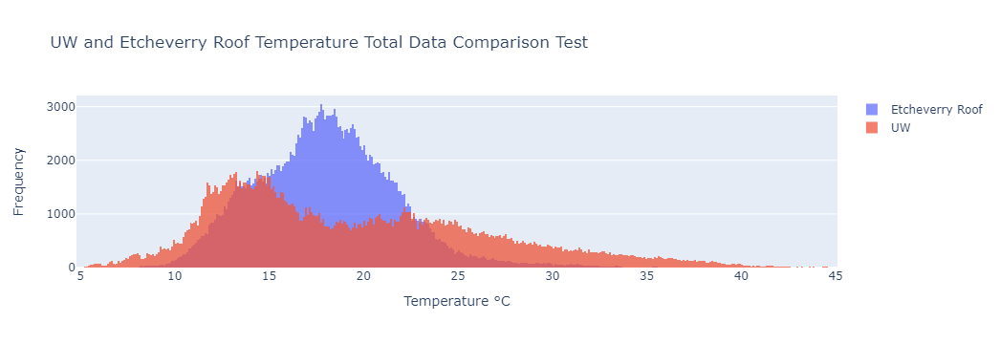

In [55]:
fig = go.Figure()
fig.add_trace(go.Histogram(x=etch_roof["temperature"], name = "Etcheverry Roof"))
fig.add_trace(go.Histogram(x=uw["temperature"], name = "UW", nbinsx = 500))
fig.update_layout(title="UW and Etcheverry Roof Temperature Total Data Comparison Test", xaxis_title="Temperature °C",yaxis_title="Frequency", barmode='overlay')
fig.update_traces(opacity=0.75)
fig.show()

Find a way to find the average weekly temperature for a location given a date and considering the week before this date
604800 seconds in a week 
subtract that from the unix time given, and find in that same data frame, the closest index to the unix time subtracted from the 604800 seconds in a week.
df.tail(nth_row_index).index[column_index]

In [56]:
splice = uw.iloc[6:12,2:]
display(splice)

,deviceTime_unix,temperature,pressure,humidity,error_flag
6,1.559341e+09,24.58,1015.50,50.90,NaN
7,1.559341e+09,24.61,1015.45,50.78,NaN
8,1.559342e+09,24.66,1015.41,50.63,NaN
9,1.559342e+09,24.70,1015.34,50.51,NaN
10,1.559342e+09,24.71,1015.26,50.41,NaN
11,1.559342e+09,24.75,1015.19,50.25,NaN


In [57]:
def a_week_back(dataframe):
    endUnix = dataframe["deviceTime_unix"][(len(dataframe)-1)]
    idealstartUnix = endUnix - 604800
    for i in range(len(dataframe)):
        if(dataframe["deviceTime_unix"][i]>=idealstartUnix):
            closestfit = i
            break
    return closestfit

# def weekly_ave(dataframe, start):
#     splice = dataframe.iloc[start:len(dataframe),:]
#     weekly_ave = splice["temperature"].sum()/(len(dataframe))
#     return weekly_ave

def weekly_ave(dataframe):
    splice = dataframe.iloc[(len(dataframe)-7):len(dataframe),:]
    weekly_ave = splice["temperature"].sum()/(len(splice)) 
    return weekly_ave

#locations and location_dfs are both lists
def create_bar_df(locations,location_dfs):
    weekly_temperature = []
    for x in range(len(location_dfs)):
        weekly_temperature.append(weekly_ave(location_dfs[x]))
    df_data = {"locations" : locations, "weekly_temp" : weekly_temperature}
    final_df = pd.DataFrame(df_data)
    return final_df

In [58]:
def a_week_back(dataframe):
    endUnix = dataframe["deviceTime_unix"][(len(dataframe)-1)]
    idealstartUnix = endUnix - 604800
    for i in range(len(dataframe)):
        if(dataframe["deviceTime_unix"][i]>=idealstartUnix):
            closestfit = i
            break
    return closestfit

# def weekly_ave(dataframe, start):
#     splice = dataframe.iloc[start:len(dataframe),:]
#     weekly_ave = splice["temperature"].sum()/(len(dataframe))
#     return weekly_ave

def weekly_ave(dataframe):
    splice = dataframe.iloc[(a_week_back(dataframe)):len(dataframe),:]
    weekly_ave = splice["temperature"].sum()/(len(splice)) 
    return weekly_ave

#locations and location_dfs are both lists
def create_bar_df(locations,location_dfs):
    weekly_temperature = []
    for x in range(len(location_dfs)):
        weekly_temperature.append(weekly_ave(location_dfs[x]))
    df_data = {"locations" : locations, "weekly_temp" : weekly_temperature}
    final_df = pd.DataFrame(df_data)
    return final_df

In [59]:
# display(uw)

# # print(weekly_ave(uw,0,216818))
# # print(weekly_ave(uw,0,216819))
# # print(uw.sum())
# print(weekly_ave(uw))
# print(uw["temperature"].mean())

sample_locs = ["UW","Etcheverry Roof"]
sample_df_list = [uw, etch_roof]

#with grab[] function you will get a location list and a df list with the data

display(create_bar_df(sample_locs, sample_df_list))

sample = create_bar_df(sample_locs, sample_df_list)

,locations,weekly_temp
0,UW,15.423636
1,Etcheverry Roof,24.085338


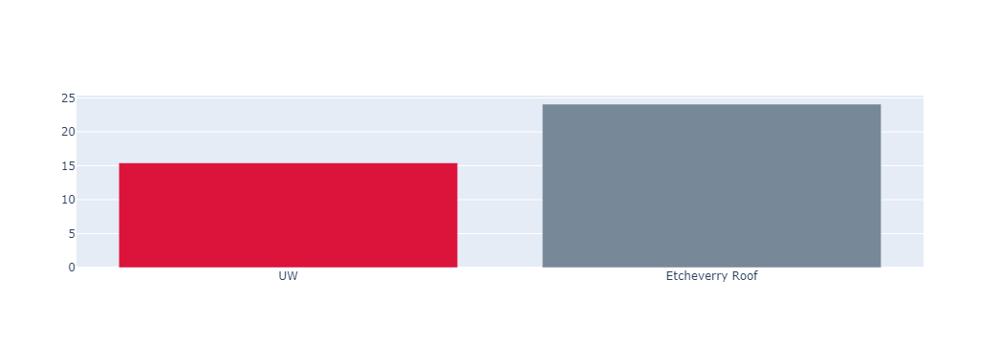

In [60]:
colors = ["crimson","lightslategray"]

fig = go.Figure(data=[go.Bar(
    x=sample["locations"],
    y=sample["weekly_temp"],
    marker_color=colors # marker color can be a single color value or an iterable
)])
fig.show()

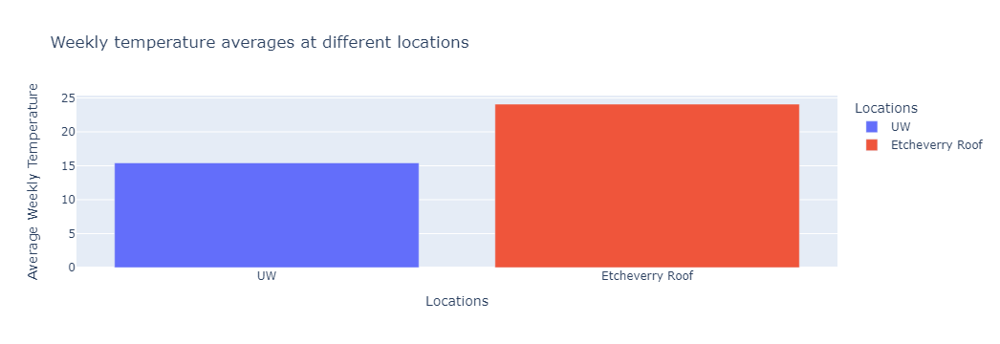

In [61]:
fig = px.bar(sample, x=sample["locations"], y = sample["weekly_temp"], title="Weekly temperature averages at different locations", labels=dict(locations="Locations", weekly_temp="Average Weekly Temperature"),
             color = "locations")

fig.update_layout(showlegend=True)
fig.show()

Sort of Part 2 of this project, we will use the grabFile command to access csv's from the internet instead of directly downloading the weather data onto our pc. Make it so that bar charts are generated from the average weekly temperature of all the stations using the functions I've defined earlier. 

**EVERYTHING UNDER THIS CELL IS ACTUALLY RELEVANT**

In [62]:
#@title IGNORE
header = {
  "User-Agent": "Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.75 Safari/537.36",
  "X-Requested-With": "XMLHttpRequest"
}


In [63]:
url="https://radwatch.berkeley.edu/test/tmp/Station.csv"
header = {
  "User-Agent": "Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/50.0.2661.75 Safari/537.36",
  "X-Requested-With": "XMLHttpRequest"
}

s=requests.get(url, headers=header).text
stations=pd.read_csv(StringIO(s))


In [64]:
#@title [GIVEN] Step 2. Import list of stations (Station.csv) and convert into DataFrame
#filePath="/Station.csv"
# This is the file path from which the CSV file containing the data is sourced.
#stations=pd.read_csv(filePath)
#This CSV file is sent to Pandas' (pd) read_csv method.
#The read_csv method saves converts CSV file as a Pandas Dataframe.


In [65]:
stations = pd.read_csv(r'C:\Users\pomar\Downloads\Station.csv')

In [66]:
#@title [GIVEN] Station data file function
import listofstations
def grabFile(nickname=""):
    try:
      url=listofstations.stationsdict[nickname] #nickname is used in URL to source CSV file for location.
      locationCSV =requests.get(url, headers=header).text #grabs the CSV file for location
      locationDF =pd.read_csv(StringIO(locationCSV)) #reads the CSV file into Pandas Dataframe.
    except: #if necessary tasks result in an error, the location is skipped
        print('FILE NOT FOUND!')
        raise Exception("Error Occured [Skipped]")
    else: #if the tasks were successful, it will do the following
        return locationDF

In [67]:
grabFile("etch_roof")

,deviceTime_utc,deviceTime_local,deviceTime_unix,cpm,cpmError,error_flag
0,2015-11-20 02:27:13+00:00,2015-11-19 18:27:13-08:00,1.447986e+09,4.0,0.894427,NaN
1,2015-11-20 02:32:13+00:00,2015-11-19 18:32:13-08:00,1.447987e+09,2.8,0.748331,NaN
2,2015-11-20 02:37:15+00:00,2015-11-19 18:37:15-08:00,1.447987e+09,3.4,0.824621,NaN
3,2015-11-20 02:42:15+00:00,2015-11-19 18:42:15-08:00,1.447987e+09,2.4,0.692820,NaN
4,2015-11-20 02:47:16+00:00,2015-11-19 18:47:16-08:00,1.447988e+09,3.4,0.824621,NaN
...,...,...,...,...,...,...
418555,2022-09-08 10:05:42+0000,2022-09-08 03:05:42-0700,1.662632e+09,2.8,0.748331,0.0
418556,2022-09-08 10:10:42+0000,2022-09-08 03:10:42-0700,1.662632e+09,2.8,0.748331,0.0
418557,2022-09-08 10:15:42+0000,2022-09-08 03:15:42-0700,1.662632e+09,3.6,0.848528,0.0
418558,2022-09-08 10:20:42+0000,2022-09-08 03:20:42-0700,1.662632e+09,2.8,0.748331,0.0


In [68]:
#@title Step 3. Grab all the station names and monthly data files. Save them as lists.
#Write your code here.
stationDFs = [] #this variable will be used to store Pandas Dataframes for each station.
areaNames = [] #this variable will be used to store the names of each station.
continents = []



for areas in range(1,len(stations.index)): #loop over the length of (# of locations in) the DataFrame
    try: #this attemps to complete necessary tasks for the location
        nickname = stations['nickname'][areas] #grab nickname from the 'nickname' column for location.
        name = stations['Name'][areas] #grabs the full name of the location
        geo = stations['timezone'][areas]
        locationDF = grabFile(nickname)
    except: #if necessary tasks result in an error, the location is skipped
        print('error occured, df for ' + nickname + ' [skipped]')
        continue
    else: #if the tasks were successful, it will do the following
        stationDFs.append(locationDF) #add dataframe to list
        areaNames.append(name) #add full name of the location to list
        continents.append(geo)
        print('done.' + nickname)
print('\n\n** complete. **')

done.lbl
done.campolindo
done.pinewood
done.etch
done.etch_roof
done.koriyama_ch
done.foothills
done.jlhs
done.ebia
done.kaist
done.alameda_hs
done.harbor_bay
FILE NOT FOUND!
error occured, df for dshs [skipped]
done.life_academy
done.KTH
done.norrareal
done.ghs
done.miramonte
done.JAEA_ms
FILE NOT FOUND!
error occured, df for hillside_high [skipped]
done.frankfurt
FILE NOT FOUND!
error occured, df for hf6 [skipped]
done.hb_os
done.ntuu_kpi
done.cnut
FILE NOT FOUND!
error occured, df for cherkasy [skipped]
done.sabacka
done.lbl_outside
FILE NOT FOUND!
error occured, df for fukushimahs [skipped]
done.miramonte_os
done.ahs_os
done.kisr-1
FILE NOT FOUND!
error occured, df for futabahighschool [skipped]
done.futabafutureschool
done.asakahighschool
FILE NOT FOUND!
error occured, df for hiroshima [skipped]
done.koriyama_ch_multi
done.pinewood_os
done.chs_os
FILE NOT FOUND!
error occured, df for fphs [skipped]
FILE NOT FOUND!
error occured, df for fphs_os [skipped]
done.msjhs
done.msjhs_os
do

In [69]:
# display(areaNames)

In [70]:
# display(stationDFs)

In [71]:
print(stationDFs[0]) #From our areaNames df we determine that this df in stationDFs corresponds to Pinewood School

                   deviceTime_utc           deviceTime_local  deviceTime_unix  \
0       2015-11-18 00:42:13+00:00  2015-11-17 16:42:13-08:00       1447807333   
1       2015-11-18 00:47:13+00:00  2015-11-17 16:47:13-08:00       1447807633   
2       2015-11-18 00:52:13+00:00  2015-11-17 16:52:13-08:00       1447807933   
3       2015-11-18 00:57:14+00:00  2015-11-17 16:57:14-08:00       1447808234   
4       2015-11-18 01:02:14+00:00  2015-11-17 17:02:14-08:00       1447808534   
...                           ...                        ...              ...   
294811  2019-01-09 09:45:33+00:00  2019-01-09 01:45:33-08:00       1547027133   
294812  2019-01-09 09:50:33+00:00  2019-01-09 01:50:33-08:00       1547027433   
294813  2019-01-09 09:55:33+00:00  2019-01-09 01:55:33-08:00       1547027733   
294814  2019-01-09 10:00:33+00:00  2019-01-09 02:00:33-08:00       1547028033   
294815  2019-01-09 10:05:33+00:00  2019-01-09 02:05:33-08:00       1547028333   

        cpm  cpmError  erro

In [72]:
sampling_start_date = []
sampling_end_date = []

def a_week_back(dataframe):
    endUnix = dataframe["deviceTime_unix"][(len(dataframe)-1)]
    idealstartUnix = endUnix - 604800
    for i in range(len(dataframe)):
        if(dataframe["deviceTime_unix"][i]>=idealstartUnix):
            closestfit = i
            break
    sampling_start_date.append(dataframe["deviceTime_utc"][i] + "UTC")
    sampling_end_date.append(dataframe["deviceTime_utc"][(len(dataframe)-1)] + "UTC")
    return closestfit

def weekly_ave(dataframe, sumover, indicator):
    splice = dataframe.iloc[(a_week_back(dataframe)):len(dataframe),:]
    if (indicator == 0):
        weekly_ave = splice[sumover].sum()/(len(splice)) 
        return weekly_ave
    else:
        weekly_ave = (math.sqrt(splice[sumover].sum()))/(len(splice.to_numpy())*5)
        return weekly_ave

#locations and location_dfs are both lists
def create_bar_df(locations,location_dfs,sumover):
    weeklyave = []
    error = []
    displaycontinents = []
    for x in range(len(location_dfs)):
        weeklyave.append(weekly_ave(location_dfs[x],sumover,0))
        error.append(weekly_ave(location_dfs[x],sumover,1))
        displaycontinents.append(continents[x][0:continents[x].index("/")])
    df_data = {"locations" : locations, sumover + "_ave" : weeklyave, "error" : error, "continents" : displaycontinents , "samplingstarts" : sampling_start_date , "samplingends" : sampling_end_date}
    final_df = pd.DataFrame(df_data)
    # final_df = final_df.sort_values(by=['continents'])
    return final_df

goal = create_bar_df(areaNames, stationDFs, "cpm")
display(goal)
# display(sampling_start_date)
# display(sampling_end_date)

ValueError: All arrays must be of the same length

In [ ]:
test = goal.to_numpy()
# display(test)

test_geo = "Antarctica/west"
# desired_str = substr(test_geo, 0, indexOf("/"))
# print(desired_str)

desired_str = test_geo[0:test_geo.index("/")]
print(desired_str)
# print(len(goal))
# print(len(test))
variable = 'this is bold'

print('this is NOT bold ' + '\033[1m' +
      goal["locations"] + '\033[0m' + ' this is NOT bold')

In [ ]:
# color = px.colors.qualitative.Plotly
# goal = goal.iloc[:,:]

fig = px.bar(goal, x=goal["locations"], y = goal["cpm_ave"], 
             title="Weekly CPM averages at different locations",  
             error_y=goal["error"],
             labels=dict(locations="Locations", cpm_ave="Average Weekly CPM", continents = "Regions"),
             # text = goal["locations"],
             # custom_data ="<b>%{text}</b><br><br>" +"Region: %{x:$,.0f}<br>" +"Average CPM (counts per minute): %{y:.0%}<br>"+"<extra></extra>",
            color = goal["continents"])

# fig.update_traces(
#     #text = goal["locations"],
#     # hoverdata=False,
#                   hovertemplate = "<b>%{x}</b>"+"<br>Region: "+goal["continents"] +"</br>Average CPM (counts per minute) : %{y}"
#                     +"<br>Data collected from <i></i> to <i></i></br>")

# for continent_name, continent in continent_data.items():
#     fig.add_trace(go.Scatter(
#         x=continent['gdpPercap'],
#         y=continent['lifeExp'],
#         name=continent_name,
#         text=continent['continent'],
#         hovertemplate=
#         "<b>%{text}</b><br><br>" +
#         "GDP per Capita: %{x:$,.0f}<br>" +
#         "Life Expectation: %{y:.0%}<br>" +
#         "Population: %{marker.size:,}" +
#         "<extra></extra>",
#         marker_size=continent['size'],
#         ))

    
fig.show()

In [ ]:
fig = px.bar(goal, x=goal["locations"], y = goal["cpm_ave"], 
             title="Weekly CPM averages at different locations",  
             error_y=goal["error"],
             labels=dict(locations="Locations", cpm_ave="Average Weekly CPM", continents = "Regions"),
            color = goal["continents"])
hover_data = np.stack((goal['continents'], goal['cpm_ave']), axis=-1)
fig.update_traces(customdata=hover_data,hovertemplate = "<b>%{x}</b>"+"<br>Region: %{customdata[0]}" +"</br>Average CPM (counts per minute) : %{customdata[1]}" +"<br>Data collected from <i></i> to <i></i></br>")
fig.show()

So now, lets review the steps needed to produce a plot with the above functions. We have a_week_back(dataframe) which will return the index that is a week behind the last entry in the dataframe. If there is no exact match between the time stamp that is exactly a week behind the last index, the function will return the closest index that is a week behind the latest entry. As such, in the case of dataframes that were sampled for less than a week, a_week_back() will just return the first index.

the weekly_ave(dataframe, sumover) will call a_week_back() and splice the argument dataframe from the index produced by a_week_back() to the latest entry. weekly_ave() will then sum over the variable specified by string sumover on the spliced dataframe and divide by the length of the spliced dataframe to get and return the weekly mean for the variable sumover.

grab_File(nickaname) accesses csv's from the internet to be used within the notebook without having to download them onto your PC. The subsequent loops that populate stationDFs and areaNames use grab_File() to attempt and access the csv for each station on the nickname column of Stations.csv, which is predownloaded and has to be manually read into a dataframe. The loops check to see if the csv is able to be accessed, and if succesful, adds the name of the locations from this csv to areaNames and adds their dataframe to stationDFs. The result is two index-for-index lists of locations and the data collected at these locations as dataframes. areaNames should be input as the locations argument and stationDFs as the location_dfs argument in create_bar_df().

the create_bar_df(locations, location_dfs, sumover) function will loop through location_dfs, which is a list of dataframes. At each dataframe within locations_dfs, the function will call weekly_ave(dataframe, sumover) and populate a list with the weekly averages of variable sumover. From the list locations, which is a list of locations that corresponds index for index to the list of weekly averages, a final dataframe is returned with two columns, one listing the locations and the other the corresponding weekly averages of some variable at those locations. 

The dataframe from create_bar_df() can then easily be formatted by plotly express to produce our desired bar graph.

So the final code that could be used for the project could:

1. Manually import Stations.csv in a df
2. define grabFile() function
3. define areaNames and stationDFs
4. Loop over the nickname column of Stations.csv, using grabFile() to fill areaNames and stationDFs with info from all accessible stations
5. define a_week_back(), weekly_ave(), and create_bar_df()
6. call create_bar_df() with areaNames, stationDFs, and the variable we want to display on the final bar graph
7. Format the create_bar_df dataframe with plotly express to produce a final graph that can be exported to HTML and displayed on the website

problems: 
there are some files which are needed for the code to run but are accessed directly donwloaded onto pc rather than from the internet, this needs to be altered so that all files are accessed from the internet so this can run from the lbl server

In [ ]:
plotly.io.to_html(fig)

In [ ]:
plotly.offline.plot(fig, filename=r'C:\Users\pomar\Downloads\plotlycpmgraph.html')